<a href="https://colab.research.google.com/github/SudoShan/digital-image-processing-pipeline/blob/main/IPA_CAT_Assignment.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [2]:
!pip install scikit-image matplotlib opencv-python

In [3]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from skimage.util import random_noise
from skimage.exposure import rescale_intensity
from skimage.metrics import peak_signal_noise_ratio as psnr, structural_similarity as ssim

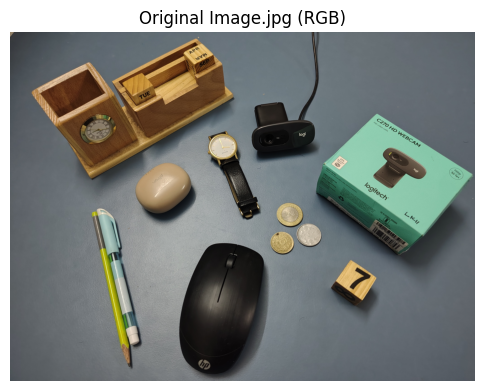

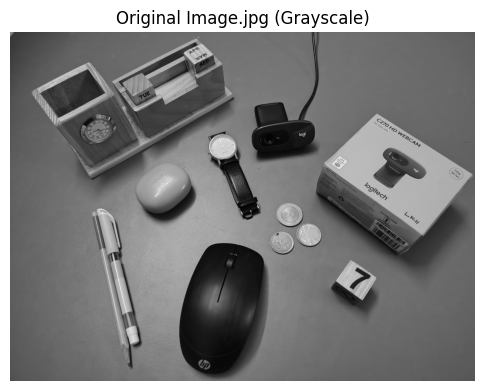

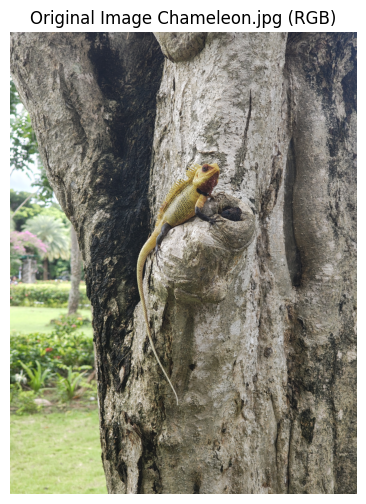

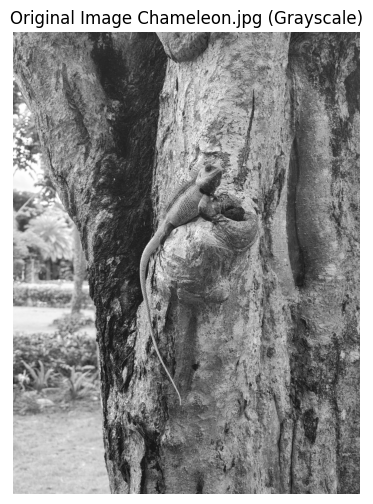

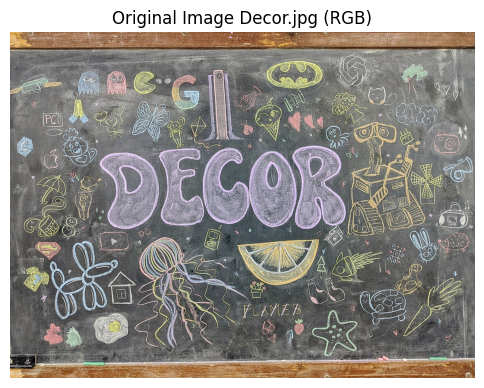

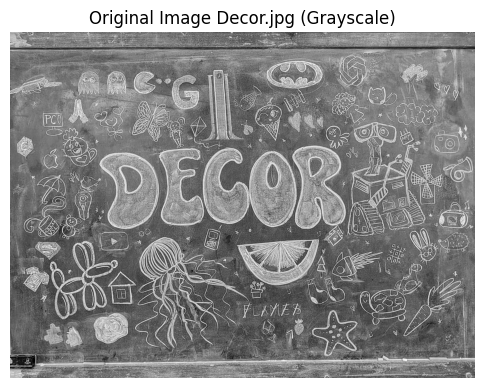

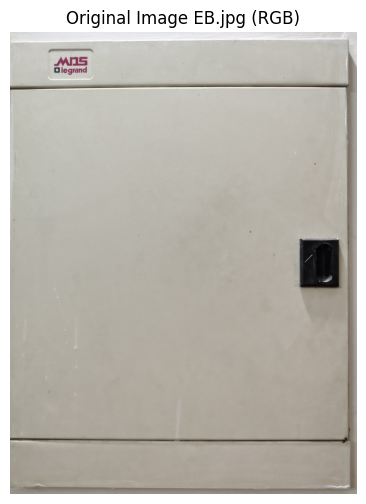

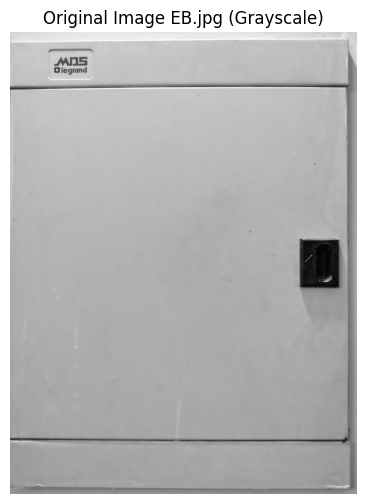

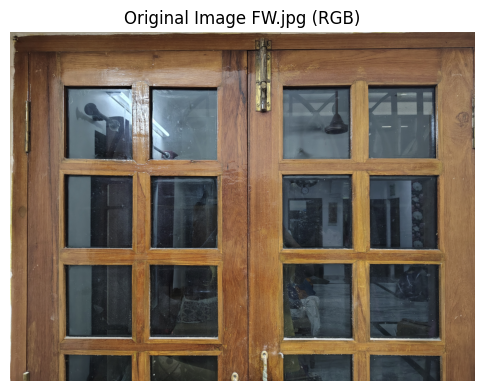

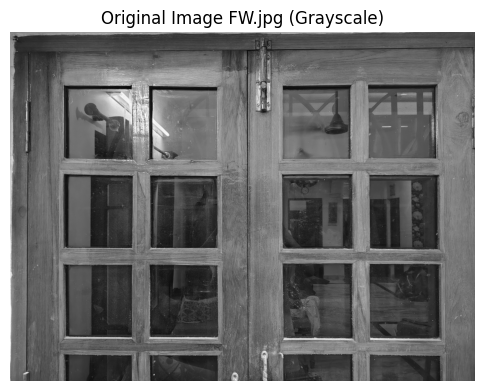

In [4]:
# List of image paths
image_paths = [
    "/content/drive/MyDrive/Image Processing and Analysis/Original Image.jpg",
    "/content/drive/MyDrive/Image Processing and Analysis/Original Image Chameleon.jpg",
    "/content/drive/MyDrive/Image Processing and Analysis/Original Image Decor.jpg",
    "/content/drive/MyDrive/Image Processing and Analysis/Original Image EB.jpg",
    "/content/drive/MyDrive/Image Processing and Analysis/Original Image FW.jpg"
]

# Dictionaries to store images
images_rgb = {}    # store RGB images
images_gray = {}   # store grayscale images

# Loop through each image
for path in image_paths:
    # Read image
    image = cv2.imread(path)

    # Convert to RGB
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    images_rgb[path] = image_rgb  # store in dict

    # Convert to Grayscale
    image_gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    images_gray[path] = image_gray  # store in dict

    # Display RGB
    plt.figure(figsize=(6,6))
    plt.imshow(image_rgb)
    plt.title(f"{path.split('/')[-1]} (RGB)")
    plt.axis("off")
    plt.show()

    # Display Grayscale
    plt.figure(figsize=(6,6))
    plt.imshow(image_gray, cmap='gray')
    plt.title(f"{path.split('/')[-1]} (Grayscale)")
    plt.axis("off")
    plt.show()


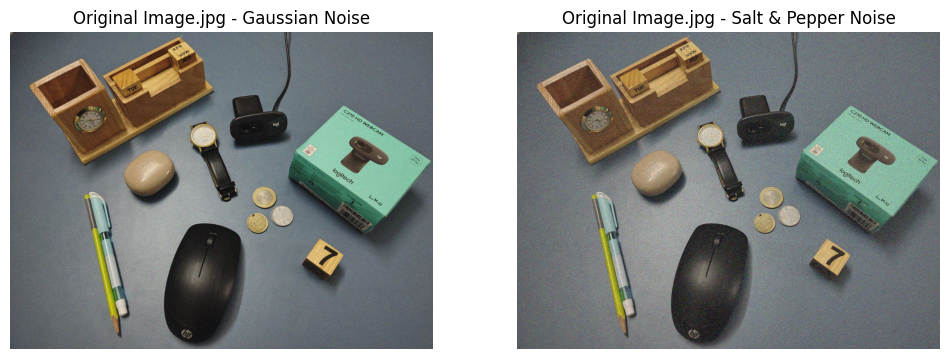

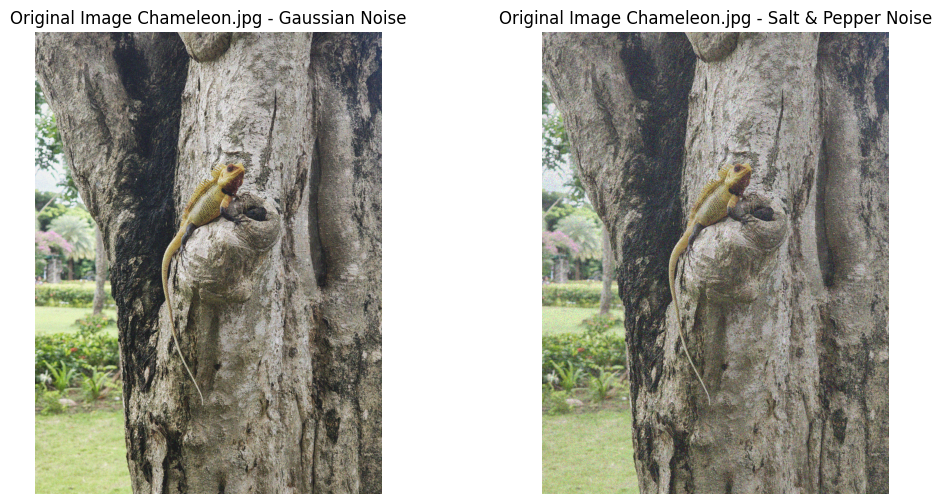

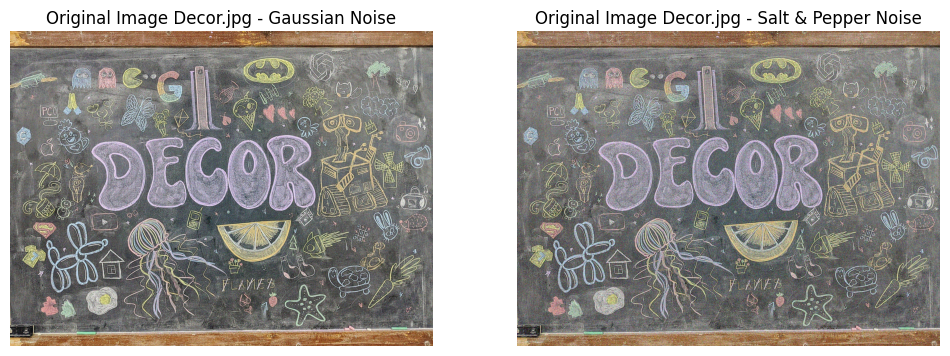

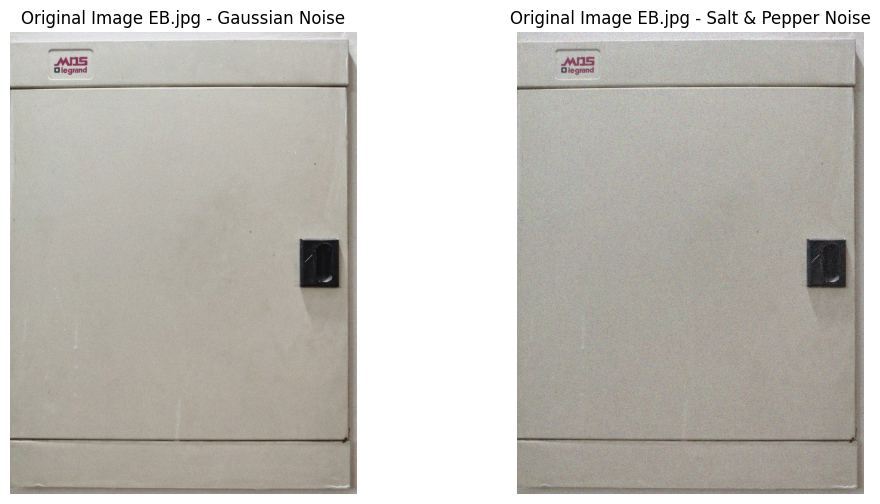

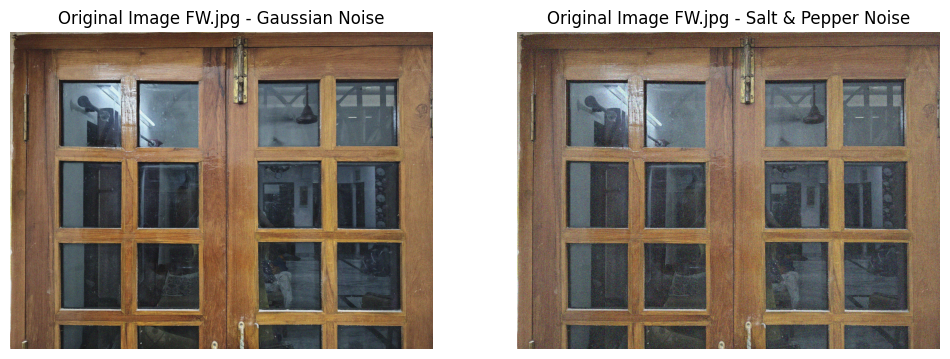

In [5]:
# Dictionaries to store noisy images
gaussian_noisy_images = {}
sp_noisy_images = {}

# Loop through each RGB image
for path, image_rgb in images_rgb.items():
    # Apply Gaussian noise
    gaussian_noisy = random_noise(image_rgb, mode='gaussian', var=0.02)
    gaussian_noisy_uint8 = (255 * gaussian_noisy).astype(np.uint8)
    gaussian_noisy_images[path] = gaussian_noisy_uint8

    # Apply Salt & Pepper noise
    sp_noisy = random_noise(image_rgb, mode='s&p', amount=0.2)
    sp_noisy_uint8 = (255 * sp_noisy).astype(np.uint8)
    sp_noisy_images[path] = sp_noisy_uint8

    # Display the noisy images
    plt.figure(figsize=(12,6))
    plt.subplot(1,2,1)
    plt.imshow(gaussian_noisy_uint8)
    plt.title(f"{path.split('/')[-1]} - Gaussian Noise")
    plt.axis("off")

    plt.subplot(1,2,2)
    plt.imshow(sp_noisy_uint8)
    plt.title(f"{path.split('/')[-1]} - Salt & Pepper Noise")
    plt.axis("off")

    plt.show()


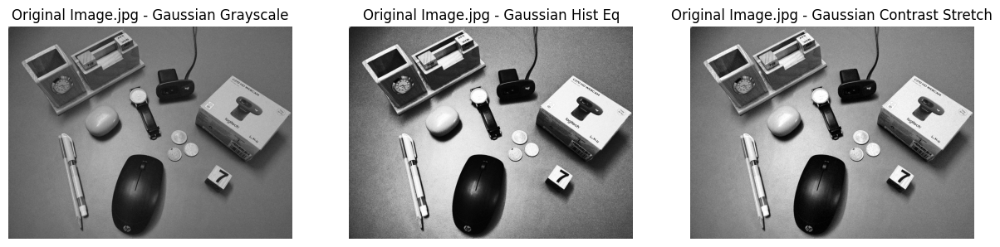

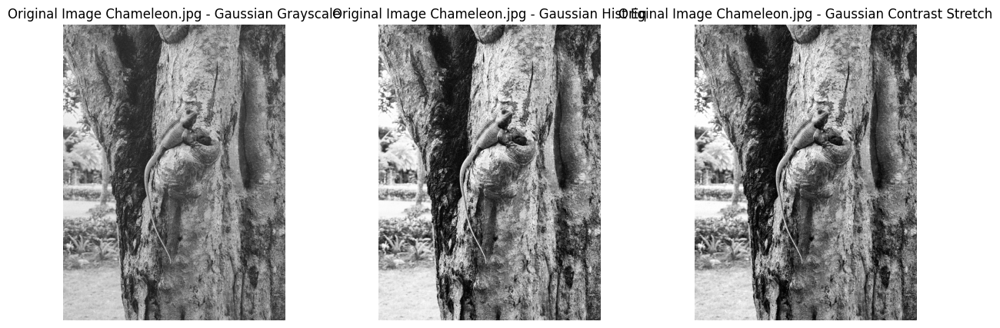

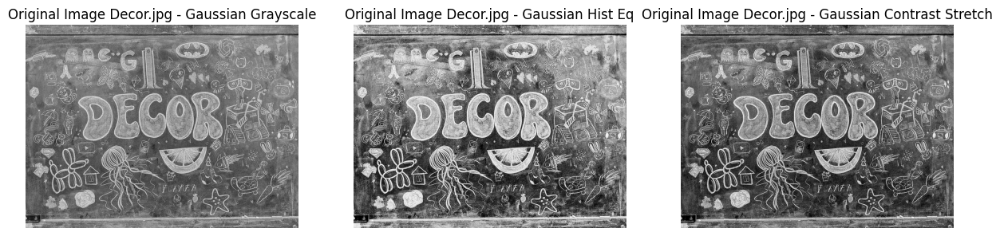

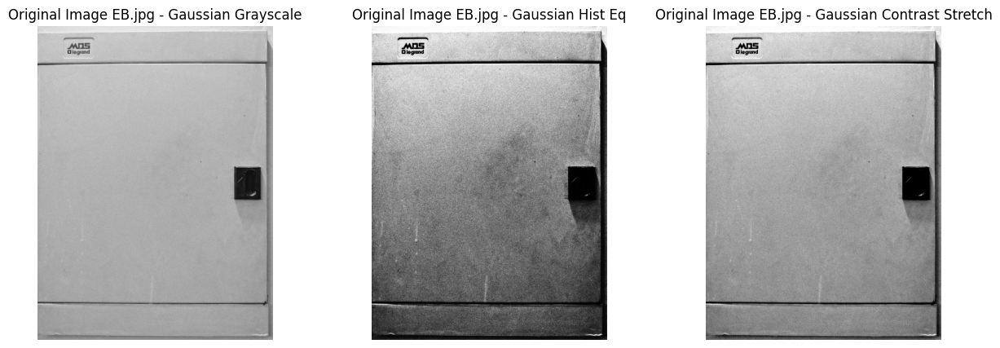

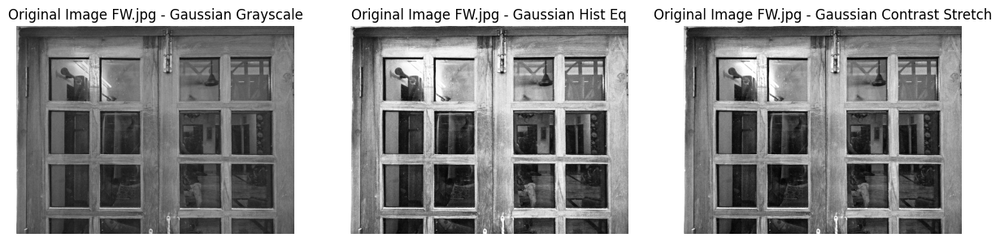

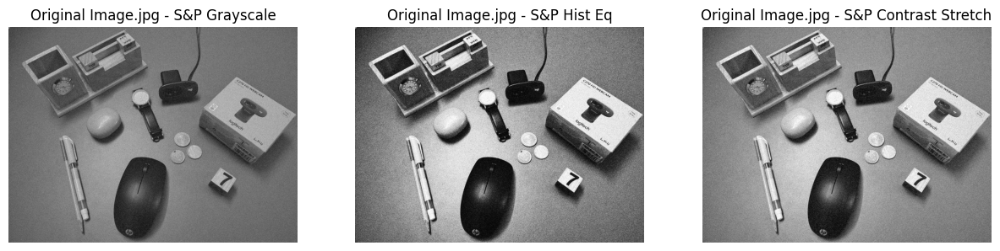

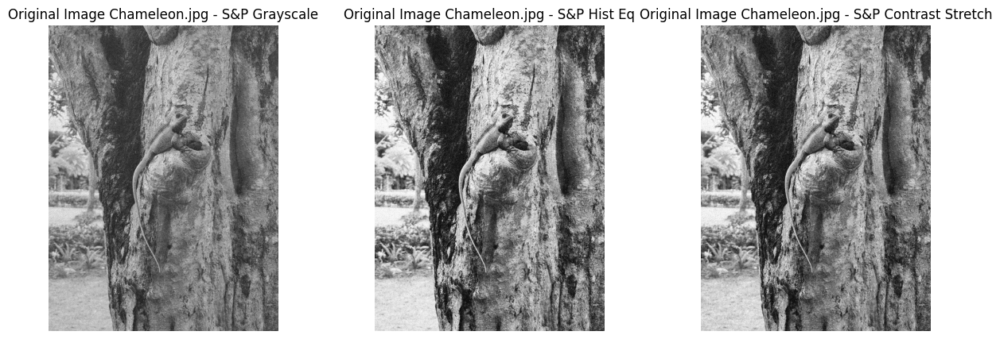

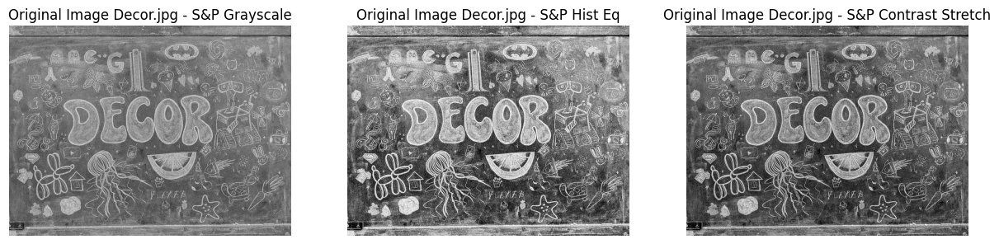

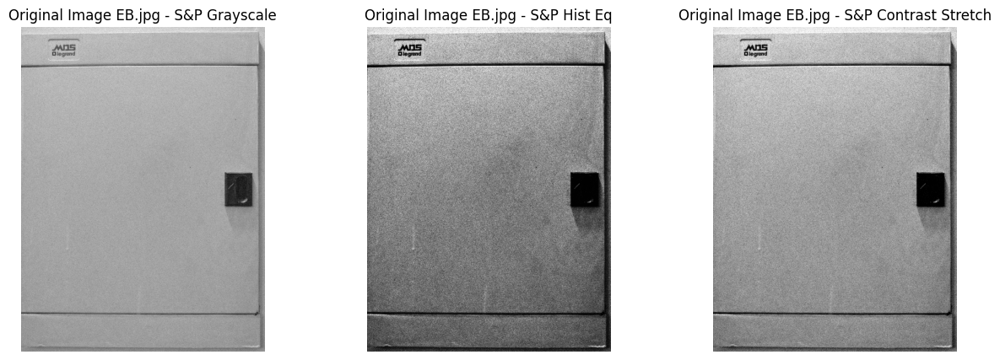

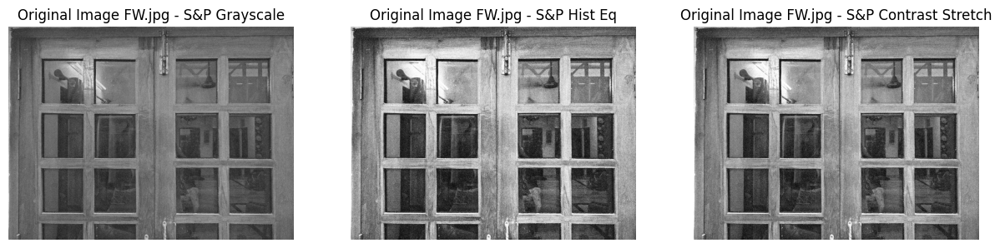

In [6]:
from skimage.exposure import rescale_intensity
# Parameters
scale = 0.5

# Dictionaries to store processed images
gauss_gray_dict = {}
gauss_hist_eq_dict = {}
gauss_contrast_dict = {}

sp_gray_dict = {}
sp_hist_eq_dict = {}
sp_contrast_dict = {}

# ---- Process Gaussian noisy images ----
for path, gauss_img in gaussian_noisy_images.items():
    # Convert to grayscale
    gray_gauss = cv2.cvtColor(gauss_img, cv2.COLOR_RGB2GRAY)
    # Resize
    resize_dim = (int(gray_gauss.shape[1]*scale), int(gray_gauss.shape[0]*scale))
    gray_gauss = cv2.resize(gray_gauss, resize_dim, interpolation=cv2.INTER_AREA)
    gauss_gray_dict[path] = gray_gauss

    # Histogram Equalization
    gauss_hist_eq = cv2.equalizeHist(gray_gauss)
    gauss_hist_eq_dict[path] = gauss_hist_eq

    # Contrast Stretching
    p2, p98 = np.percentile(gray_gauss, (2, 98))
    gauss_contrast = rescale_intensity(gray_gauss, in_range=(p2, p98))
    gauss_contrast_dict[path] = gauss_contrast

    # Display
    plt.figure(figsize=(15,5))
    plt.subplot(1,3,1)
    plt.imshow(gray_gauss, cmap='gray')
    plt.title(f"{path.split('/')[-1]} - Gaussian Grayscale")
    plt.axis("off")

    plt.subplot(1,3,2)
    plt.imshow(gauss_hist_eq, cmap='gray')
    plt.title(f"{path.split('/')[-1]} - Gaussian Hist Eq")
    plt.axis("off")

    plt.subplot(1,3,3)
    plt.imshow(gauss_contrast, cmap='gray')
    plt.title(f"{path.split('/')[-1]} - Gaussian Contrast Stretch")
    plt.axis("off")

    plt.show()

# ---- Process Salt & Pepper noisy images ----
for path, sp_img in sp_noisy_images.items():
    # Convert to grayscale
    gray_sp = cv2.cvtColor(sp_img, cv2.COLOR_RGB2GRAY)
    # Resize
    resize_dim = (int(gray_sp.shape[1]*scale), int(gray_sp.shape[0]*scale))
    gray_sp = cv2.resize(gray_sp, resize_dim, interpolation=cv2.INTER_AREA)
    sp_gray_dict[path] = gray_sp

    # Histogram Equalization
    sp_hist_eq = cv2.equalizeHist(gray_sp)
    sp_hist_eq_dict[path] = sp_hist_eq

    # Contrast Stretching
    p2, p98 = np.percentile(gray_sp, (2, 98))
    sp_contrast = rescale_intensity(gray_sp, in_range=(p2, p98))
    sp_contrast_dict[path] = sp_contrast

    # Display
    plt.figure(figsize=(15,5))
    plt.subplot(1,3,1)
    plt.imshow(gray_sp, cmap='gray')
    plt.title(f"{path.split('/')[-1]} - S&P Grayscale")
    plt.axis("off")

    plt.subplot(1,3,2)
    plt.imshow(sp_hist_eq, cmap='gray')
    plt.title(f"{path.split('/')[-1]} - S&P Hist Eq")
    plt.axis("off")

    plt.subplot(1,3,3)
    plt.imshow(sp_contrast, cmap='gray')
    plt.title(f"{path.split('/')[-1]} - S&P Contrast Stretch")
    plt.axis("off")

    plt.show()


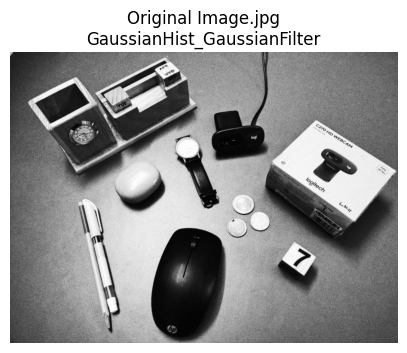

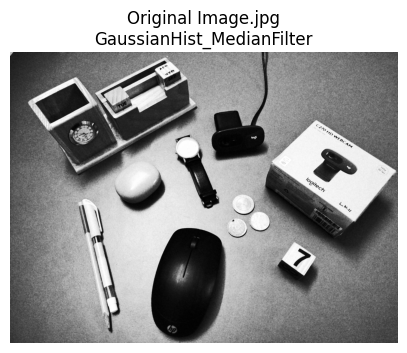

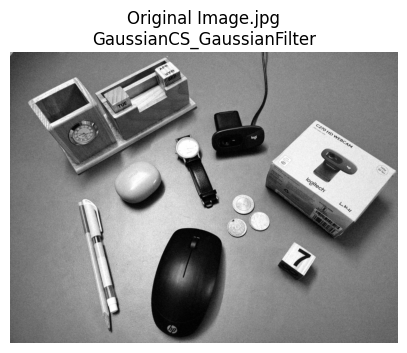

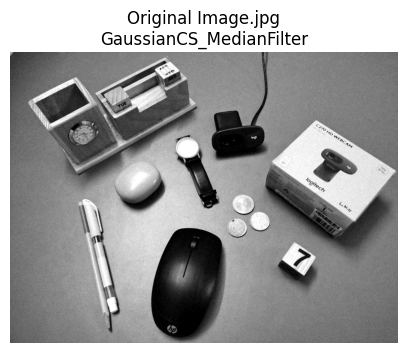

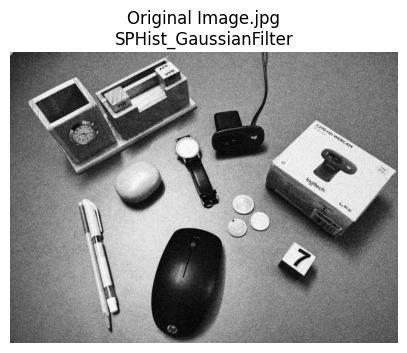

...

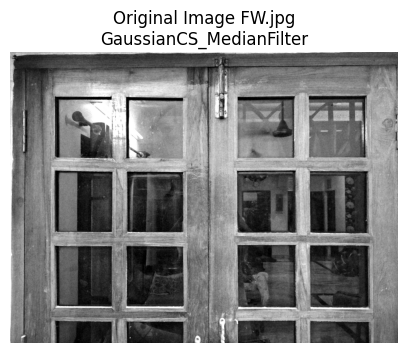

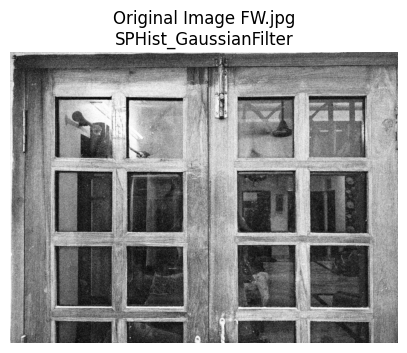

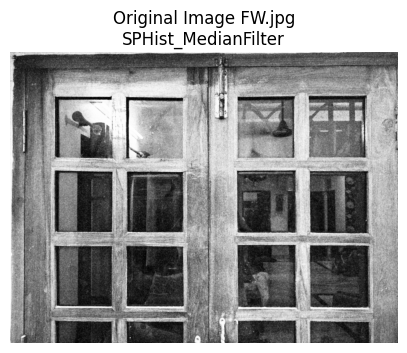

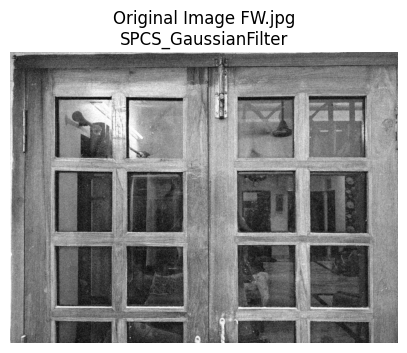

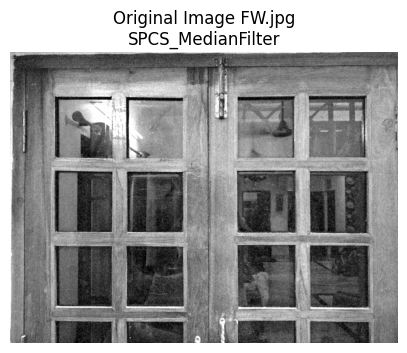

In [7]:
from skimage.metrics import structural_similarity as ssim
import cv2
import matplotlib.pyplot as plt

# Parameters
scale = 0.5

# Dictionaries to store filtered results
filtered_results_dict = {}

# Loop through all images
for path in images_gray.keys():
    # Original grayscale resized
    image_gray_resized = cv2.resize(images_gray[path],
                                    (int(images_gray[path].shape[1]*scale), int(images_gray[path].shape[0]*scale)),
                                    interpolation=cv2.INTER_AREA)

    # Get processed images for this path
    gauss_hist = gauss_hist_eq_dict[path]
    gauss_contrast_img = gauss_contrast_dict[path]
    sp_hist = sp_hist_eq_dict[path]
    sp_contrast_img = sp_contrast_dict[path]

    # Dictionary to store filtered images for this particular image
    results = {}

    # --- Gaussian Noise + HistEq ---
    results["GaussianHist_GaussianFilter"] = cv2.GaussianBlur(gauss_hist, (5,5), 0)
    results["GaussianHist_MedianFilter"] = cv2.medianBlur(gauss_hist, 5)

    # --- Gaussian Noise + Contrast Stretching ---
    results["GaussianCS_GaussianFilter"] = cv2.GaussianBlur(gauss_contrast_img, (5,5), 0)
    results["GaussianCS_MedianFilter"] = cv2.medianBlur(gauss_contrast_img, 5)

    # --- Salt & Pepper Noise + HistEq ---
    results["SPHist_GaussianFilter"] = cv2.GaussianBlur(sp_hist, (5,5), 0)
    results["SPHist_MedianFilter"] = cv2.medianBlur(sp_hist, 5)

    # --- Salt & Pepper Noise + Contrast Stretching ---
    results["SPCS_GaussianFilter"] = cv2.GaussianBlur(sp_contrast_img, (5,5), 0)
    results["SPCS_MedianFilter"] = cv2.medianBlur(sp_contrast_img, 5)

    # Store filtered results
    filtered_results_dict[path] = results

    # Display filtered images
    for title, img in results.items():
        plt.figure(figsize=(5,5))
        plt.imshow(img, cmap='gray')
        plt.title(f"{path.split('/')[-1]}\n{title}")
        plt.axis("off")
        plt.show()


In [8]:
# ---------- Imports ----------
import cv2
import numpy as np
import matplotlib.pyplot as plt
from skimage import measure, color, morphology
from skimage.filters import threshold_local
from skimage.measure import regionprops
from skimage.morphology import closing, square, remove_small_objects
from scipy import ndimage as ndi

# ---------- Helper functions ----------
def to_display_rgb(img):
    """Ensure an image is uint8 RGB for plotting with plt.imshow."""
    if img is None:
        return None
    if img.dtype != np.uint8:
        img = (255 * (img - img.min()) / (img.max() - img.min() + 1e-9)).astype(np.uint8)
    if img.ndim == 2:
        return cv2.cvtColor(img, cv2.COLOR_GRAY2RGB)
    return img

def compute_color_histogram(rgb_image, bbox, bins=16):
    """Compute normalized color histogram for a bounding box region.
       rgb_image: uint8 RGB image
       bbox: (min_row, min_col, max_row, max_col)
    """
    minr, minc, maxr, maxc = bbox
    patch = rgb_image[minr:maxr, minc:maxc]
    if patch.size == 0:
        return np.zeros((3*bins,))
    hist = []
    for ch in range(3):
        h = np.histogram(patch[:,:,ch], bins=bins, range=(0,255))[0].astype(float)
        if h.sum() > 0:
            h = h / h.sum()
        hist.append(h)
    return np.concatenate(hist)

def dice_coefficient(mask1, mask2):
    """Compute Dice coefficient between two boolean masks."""
    mask1 = mask1.astype(bool)
    mask2 = mask2.astype(bool)
    inter = np.logical_and(mask1, mask2).sum()
    s = mask1.sum() + mask2.sum()
    if s == 0:
        return 1.0
    return 2.0 * inter / s

def annotate_regions_on_image(rgb_img, regions, color_box=(0,255,0), color_centroid=(255,0,0)):
    """Draw bounding boxes and centroids on a copy of rgb_img (uint8 RGB)."""
    out = rgb_img.copy()
    for r in regions:
        minr, minc, maxr, maxc = r.bbox
        # draw rectangle
        cv2.rectangle(out, (minc, minr), (maxc, maxr), color_box, 2)
        # draw centroid
        cy, cx = r.centroid
        cv2.circle(out, (int(cx), int(cy)), 3, color_centroid, -1)
        # put area text
        cv2.putText(out, f"A:{int(r.area)}", (minc, max(15, minr-8)), cv2.FONT_HERSHEY_SIMPLEX, 0.4, color_box, 1)
    return out


In [9]:
def adaptive_threshold_segmentation(gray, block_size=51, offset=10, min_size=100):
    """
    Adaptive threshold segmentation using skimage threshold_local and morphological ops.
    Returns a boolean mask (True = foreground).
    """
    # Ensure gray in uint8
    if gray.dtype != np.uint8:
        gray_u8 = (255 * (gray - gray.min()) / (gray.max() - gray.min() + 1e-9)).astype(np.uint8)
    else:
        gray_u8 = gray
    # local threshold
    t = threshold_local(gray_u8, block_size, offset=offset, method='mean')
    mask = gray_u8 > t
    # morphological cleanup: close and remove small objects
    mask = closing(mask, square(3))
    mask = remove_small_objects(mask, min_size=min_size)
    mask = ndi.binary_fill_holes(mask)
    return mask

def edge_based_segmentation(rgb_or_gray, canny_sigma=1.0, closing_size=5, min_size=100):
    """
    Edge-based segmentation:
     - convert to grayscale if color passed
     - apply Canny -> dilate/close -> fill holes -> remove small objects
    returns boolean mask
    """
    if rgb_or_gray.ndim == 3:
        gray = cv2.cvtColor(rgb_or_gray, cv2.COLOR_RGB2GRAY)
    else:
        gray = rgb_or_gray
    # normalize for Canny
    if gray.dtype != np.uint8:
        gray_u8 = (255 * (gray - gray.min()) / (gray.max() - gray.min() + 1e-9)).astype(np.uint8)
    else:
        gray_u8 = gray
    edges = cv2.Canny(gray_u8, threshold1=50, threshold2=150, apertureSize=3)
    # Dilate / close to form borders
    kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (closing_size, closing_size))
    closed = cv2.morphologyEx(edges, cv2.MORPH_CLOSE, kernel)
    # fill holes by finding connected components on inverted edges
    closed_bool = closed.astype(bool)
    # invert to get regions
    mask = ndi.binary_fill_holes(closed_bool)
    # we likely want regions where gradient exists -> refine by using thresholded intensity
    # Use Otsu or simple threshold to define candidate interiors
    _, thr = cv2.threshold(gray_u8, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
    mask2 = thr.astype(bool)
    # combine structural mask and intensity mask
    combined = np.logical_or(mask, mask2)
    combined = closing(combined, square(3))
    combined = remove_small_objects(combined, min_size=min_size)
    combined = ndi.binary_fill_holes(combined)
    return combined


In [10]:
def extract_features_and_annotate(rgb_image, mask, min_area_filter=50):
    """
    Input:
     - rgb_image: uint8 RGB image
     - mask: boolean mask (True = object)
    Returns:
     - regions (list of skimage regionprops)
     - annotated_rgb (uint8) with boxes + centroids
     - features_list: list of dicts {area, centroid, bbox, color_hist}
    """
    labeled = measure.label(mask)
    props = regionprops(labeled)
    # filter small regions
    props = [p for p in props if p.area >= min_area_filter]
    features = []
    for p in props:
        bbox = p.bbox  # (minr, minc, maxr, maxc)
        hist = compute_color_histogram(rgb_image, bbox, bins=16)
        features.append({
            'area': p.area,
            'centroid': p.centroid,
            'bbox': bbox,
            'eccentricity': p.eccentricity,
            'extent': p.extent,
            'color_hist': hist
        })
    annotated = annotate_regions_on_image(rgb_image, props)
    return props, annotated, features


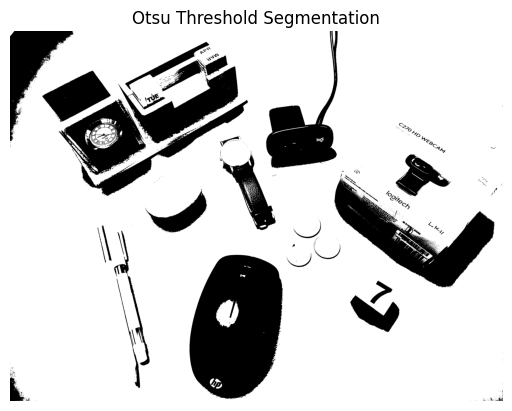

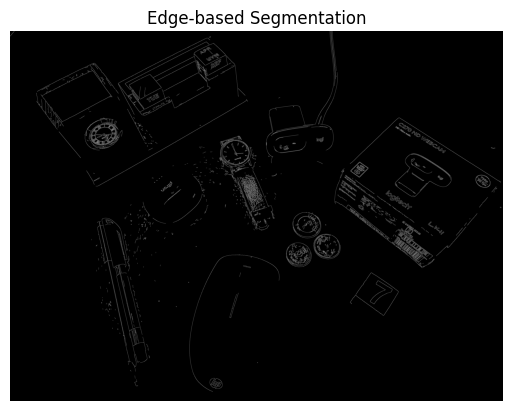

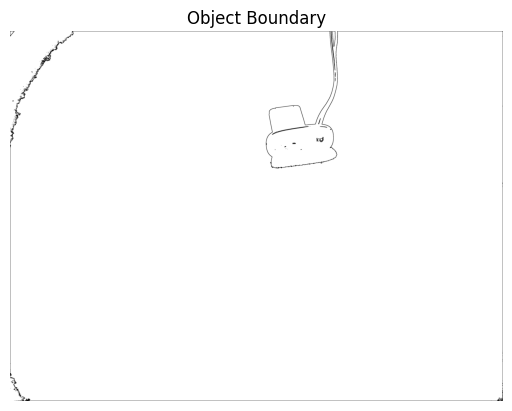

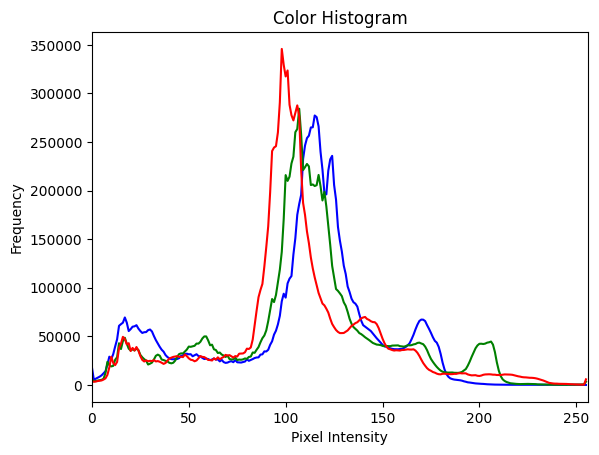

In [11]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Load and convert
img = cv2.imread( "/content/drive/MyDrive/Image Processing and Analysis/Original Image.jpg")
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

# Apply Otsu's threshold
_, mask_thresh = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)

plt.imshow(mask_thresh, cmap='gray')
plt.title('Otsu Threshold Segmentation')
plt.axis('off')
plt.show()

edges = cv2.Canny(gray, 100, 200)

plt.imshow(edges, cmap='gray')
plt.title('Edge-based Segmentation')
plt.axis('off')
plt.show()

# Find contours on thresholded image
contours, _ = cv2.findContours(mask_thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
boundary = np.ones_like(gray)*255
cv2.drawContours(boundary, contours, -1, (0), 2)

plt.imshow(boundary, cmap='gray')
plt.title('Object Boundary')
plt.axis('off')
plt.show()

colors = ('b','g','r')
for i,col in enumerate(colors):
    hist = cv2.calcHist([img],[i],None,[256],[0,256])
    plt.plot(hist, color=col)
    plt.xlim([0,256])
plt.title('Color Histogram')
plt.xlabel('Pixel Intensity')
plt.ylabel('Frequency')
plt.show()


Area: 0.00, Centroid: (0, 0), Bounding Box: (2231, 3071, 1, 1)
Area: 0.00, Centroid: (0, 0), Bounding Box: (2222, 3071, 2, 1)
Area: 0.00, Centroid: (0, 0), Bounding Box: (2172, 3071, 1, 1)
Area: 0.00, Centroid: (0, 0), Bounding Box: (2039, 3071, 1, 1)
Area: 0.00, Centroid: (0, 0), Bounding Box: (1936, 3071, 1, 1)
Area: 0.00, Centroid: (0, 0), Bounding Box: (1842, 3071, 1, 1)
Area: 0.00, Centroid: (0, 0), Bounding Box: (1812, 3071, 1, 1)
Area: 0.00, Centroid: (0, 0), Bounding Box: (1743, 3071, 1, 1)
Area: 0.00, Centroid: (0, 0), Bounding Box: (1724, 3071, 2, 1)
Area: 0.00, Centroid: (0, 0), Bounding Box: (1605, 3071, 1, 1)
Area: 0.00, Centroid: (0, 0), Bounding Box: (1508, 3071, 1, 1)
Area: 0.00, Centroid: (0, 0), Bounding Box: (1496, 3071, 1, 1)
Area: 0.00, Centroid: (0, 0), Bounding Box: (1485, 3071, 1, 1)
Area: 0.00, Centroid: (0, 0), Bounding Box: (1471, 3071, 1, 1)
Area: 0.00, Centroid: (0, 0), Bounding Box: (1433, 3071, 2, 1)
Area: 0.00, Centroid: (0, 0), Bounding Box: (1419, 3071

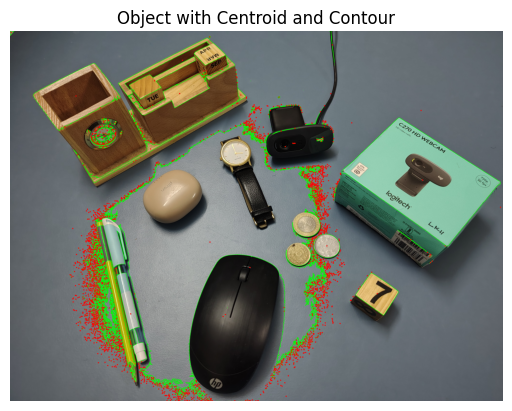

In [15]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Read and convert to grayscale
img = cv2.imread("/content/drive/MyDrive/Image Processing and Analysis/Original Image.jpg")
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

# Threshold to create binary mask
_, mask = cv2.threshold(gray, 128, 255, cv2.THRESH_BINARY)

# Find contours
contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

annotated = img.copy()
for cnt in contours:
    area = cv2.contourArea(cnt)
    M = cv2.moments(cnt)
    if M["m00"] != 0:
        cx = int(M["m10"] / M["m00"])
        cy = int(M["m01"] / M["m00"])
    else:
        cx, cy = 0, 0

    x, y, w, h = cv2.boundingRect(cnt)
    print(f"Area: {area:.2f}, Centroid: ({cx}, {cy}), Bounding Box: ({x}, {y}, {w}, {h})")

    cv2.drawContours(annotated, [cnt], -1, (0, 255, 0), 2)
    cv2.circle(annotated, (cx, cy), 5, (0, 0, 255), -1)

plt.imshow(cv2.cvtColor(annotated, cv2.COLOR_BGR2RGB))
plt.title("Object with Centroid and Contour")
plt.axis("off")
plt.show()


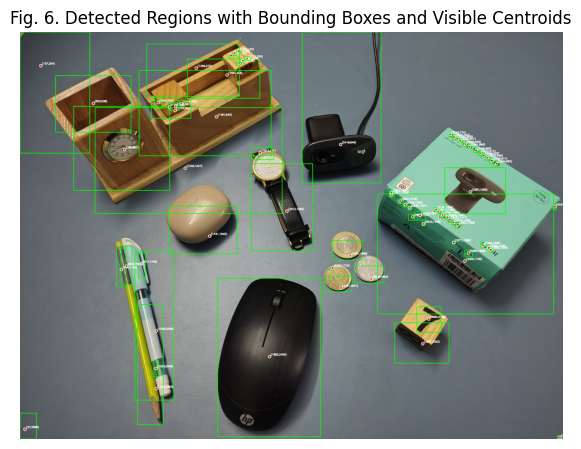

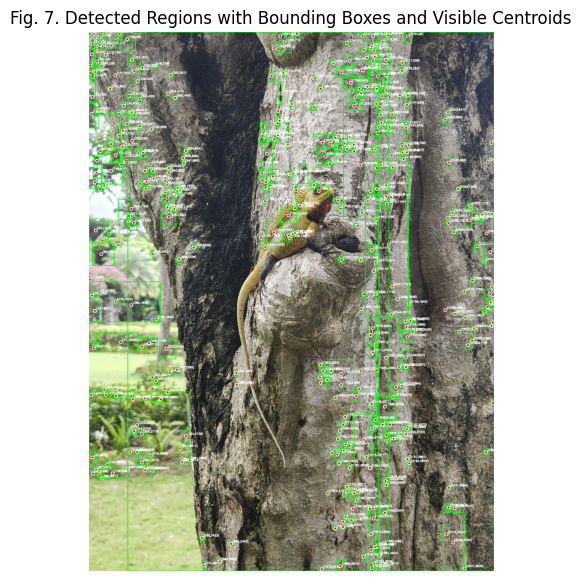

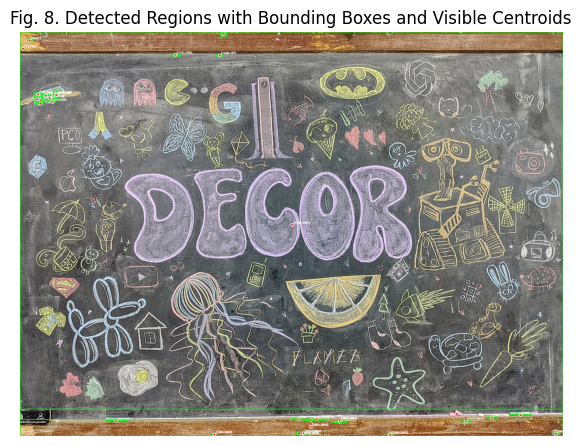

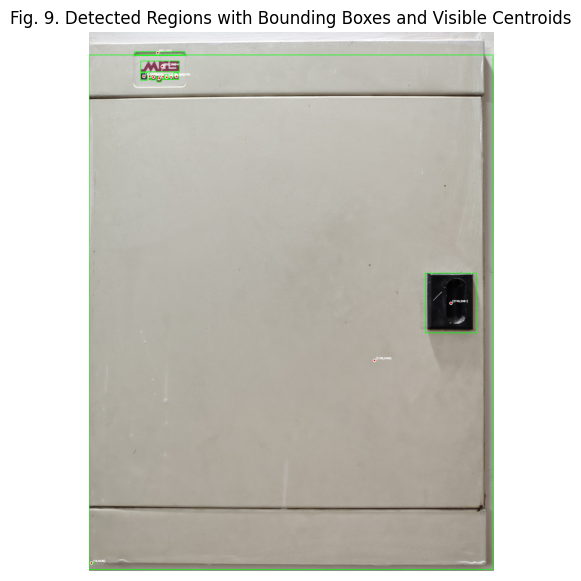

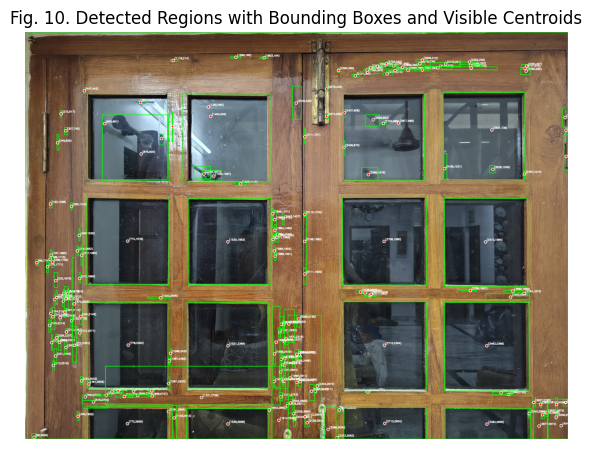

In [16]:
for i, (path, gray_image) in enumerate(images_gray.items(), start=1):
    # --- Step 1: Thresholding ---
    _, thresh = cv2.threshold(gray_image, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)

    # --- Step 2: Contour Detection ---
    contours, _ = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    # --- Step 3: Draw on RGB copy ---
    output = images_rgb[path].copy()

    for c in contours:
        area = cv2.contourArea(c)
        if area < 150:  # filter small noise
            continue

        # Bounding box
        x, y, w, h = cv2.boundingRect(c)
        cv2.rectangle(output, (x, y), (x + w, y + h), (0, 255, 0), 3)  # Thicker green box

        # Centroid
        M = cv2.moments(c)
        if M["m00"] != 0:
            cx = int(M["m10"] / M["m00"])
            cy = int(M["m01"] / M["m00"])

            # Draw visible centroid (red with white outline)
            cv2.circle(output, (cx, cy), 10, (255, 255, 255), 3)  # white border
            cv2.circle(output, (cx, cy), 6, (255, 0, 0), -1)      # inner red

            # Optional coordinate label
            cv2.putText(output, f"({cx},{cy})", (cx + 10, cy - 10),
                        cv2.FONT_HERSHEY_SIMPLEX, 0.6, (255, 255, 255), 2, cv2.LINE_AA)

    # --- Step 4: Display Result ---
    plt.figure(figsize=(7, 7))
    plt.imshow(output)
    plt.title(f"Fig. {i+5}. Detected Regions with Bounding Boxes and Visible Centroids")
    plt.axis("off")
    plt.show()


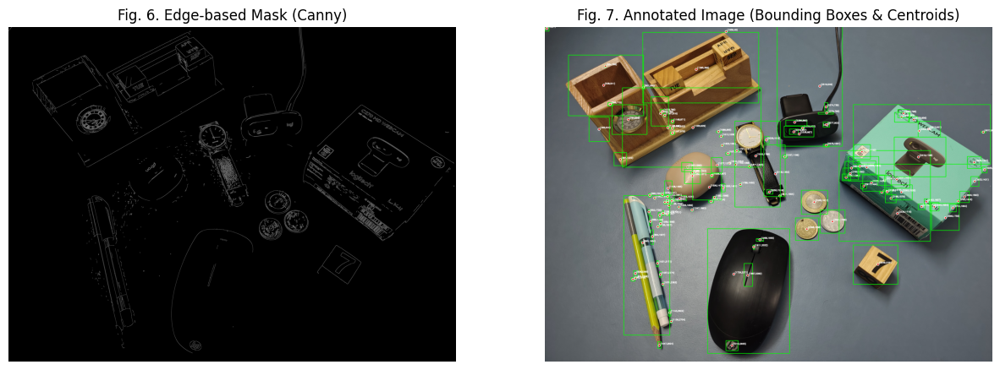

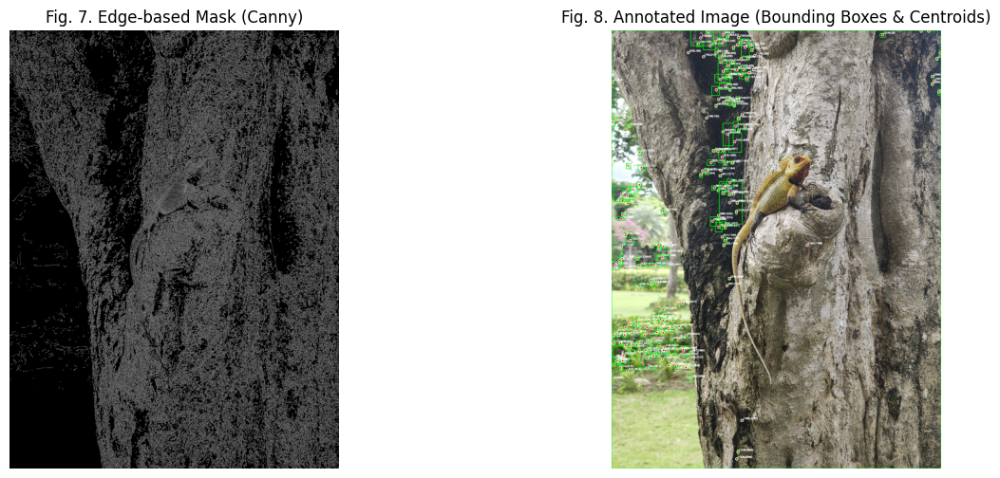

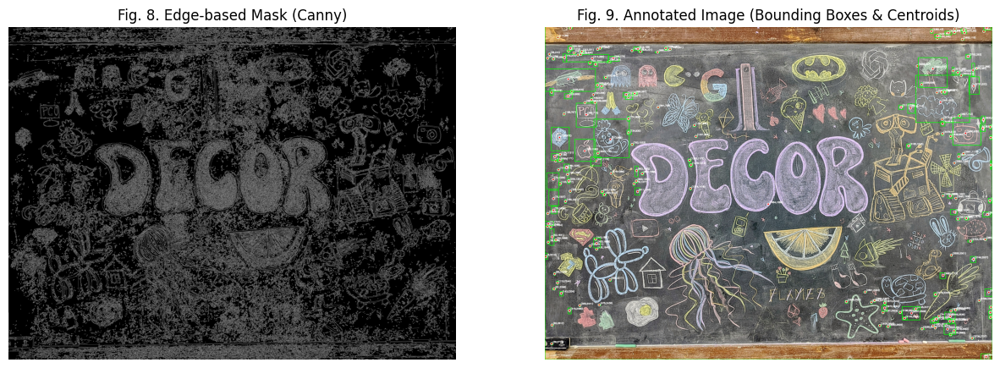

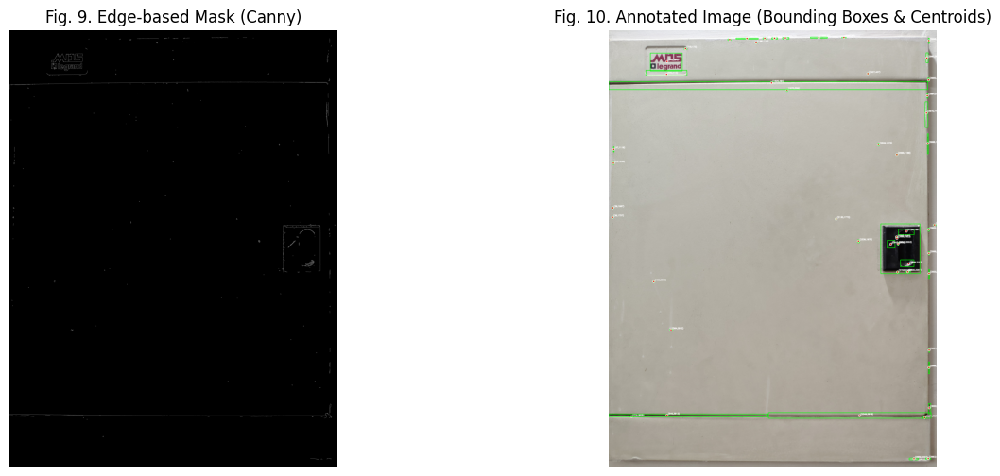

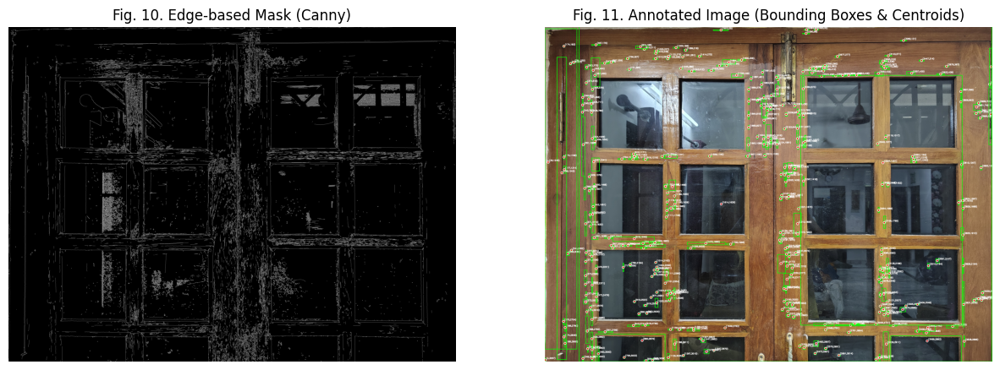

In [17]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

for i, (path, gray_image) in enumerate(images_gray.items(), start=1):
    # --- Step 1: Edge Detection ---
    edges = cv2.Canny(gray_image, 100, 200)   # You can tune thresholds (100, 200)

    # --- Step 2: Dilate + Close small gaps ---
    kernel = np.ones((3,3), np.uint8)
    edges_dilated = cv2.dilate(edges, kernel, iterations=2)
    edges_closed = cv2.morphologyEx(edges_dilated, cv2.MORPH_CLOSE, kernel, iterations=2)

    # --- Step 3: Find contours from edges ---
    contours, _ = cv2.findContours(edges_closed, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    # --- Step 4: Copy RGB image for drawing ---
    output = images_rgb[path].copy()

    # --- Step 5: Draw bounding boxes and centroids ---
    for c in contours:
        area = cv2.contourArea(c)
        if area < 150:   # ignore small noise
            continue

        # Bounding box (green)
        x, y, w, h = cv2.boundingRect(c)
        cv2.rectangle(output, (x, y), (x + w, y + h), (0, 255, 0), 3)

        # Centroid (red with white border)
        M = cv2.moments(c)
        if M["m00"] != 0:
            cx = int(M["m10"] / M["m00"])
            cy = int(M["m01"] / M["m00"])
            cv2.circle(output, (cx, cy), 10, (255, 255, 255), 3)  # white border
            cv2.circle(output, (cx, cy), 6, (255, 0, 0), -1)      # inner red
            cv2.putText(output, f"({cx},{cy})", (cx + 10, cy - 10),
                        cv2.FONT_HERSHEY_SIMPLEX, 0.6, (255, 255, 255), 2, cv2.LINE_AA)

    # --- Step 6: Display results ---
    plt.figure(figsize=(15,6))

    plt.subplot(1,2,1)
    plt.imshow(edges, cmap='gray')
    plt.title(f"Fig. {i+5}. Edge-based Mask (Canny)")
    plt.axis("off")

    plt.subplot(1,2,2)
    plt.imshow(output)
    plt.title(f"Fig. {i+6}. Annotated Image (Bounding Boxes & Centroids)")
    plt.axis("off")

    plt.show()



Processing grayscale filtered variants of: Original Image.jpg


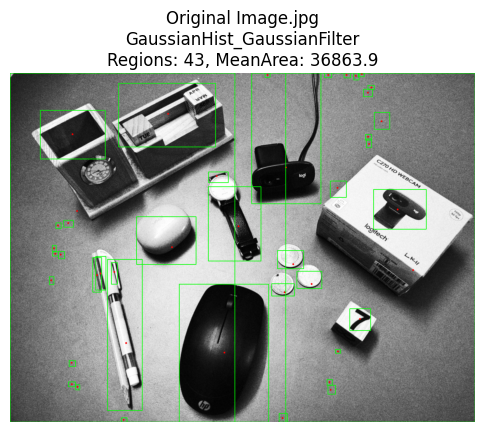

  GaussianHist_GaussianFilter: regions=43, mean_area=36863.9, PSNR=16.77, SSIM=0.6040


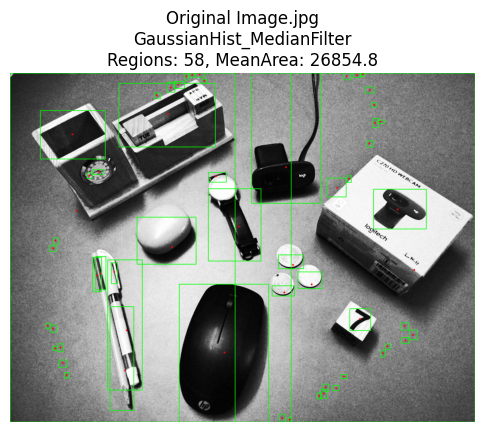

  GaussianHist_MedianFilter: regions=58, mean_area=26854.8, PSNR=16.15, SSIM=0.5819


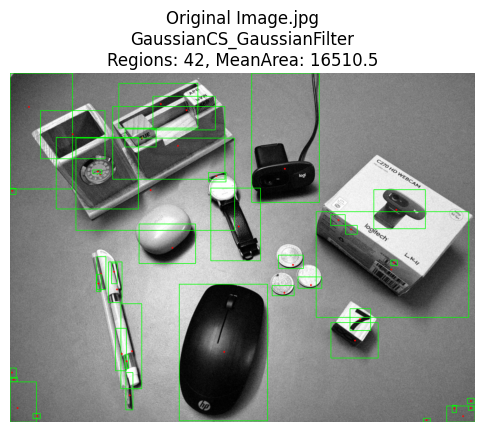

  GaussianCS_GaussianFilter: regions=42, mean_area=16510.5, PSNR=19.20, SSIM=0.7632


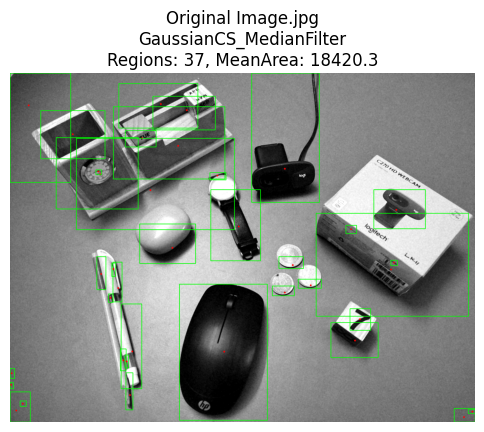

  GaussianCS_MedianFilter: regions=37, mean_area=18420.3, PSNR=18.99, SSIM=0.7430


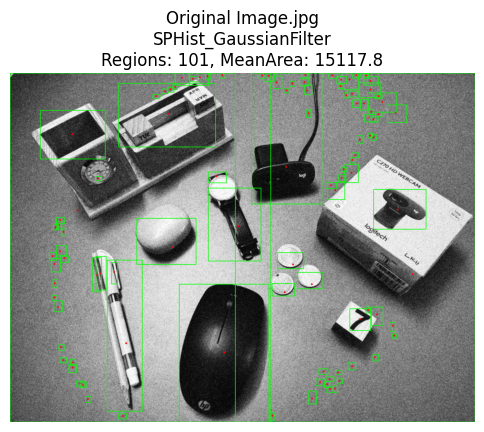

  SPHist_GaussianFilter: regions=101, mean_area=15117.8, PSNR=18.21, SSIM=0.4430


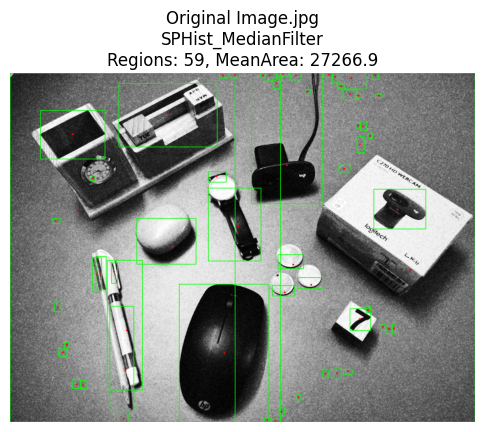

  SPHist_MedianFilter: regions=59, mean_area=27266.9, PSNR=17.00, SSIM=0.4637


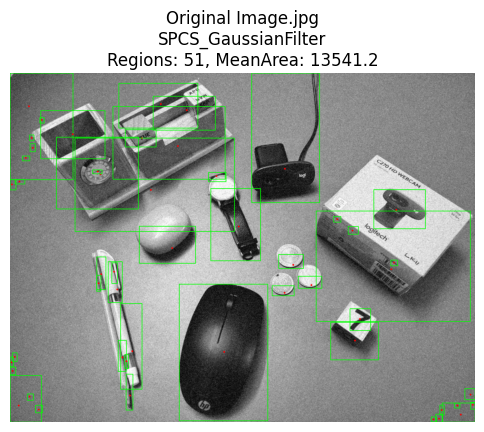

  SPCS_GaussianFilter: regions=51, mean_area=13541.2, PSNR=18.61, SSIM=0.5643


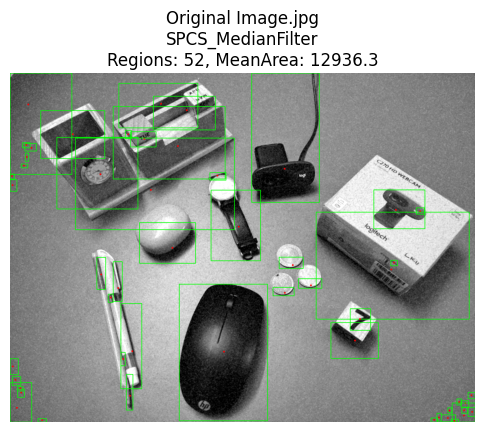

  SPCS_MedianFilter: regions=52, mean_area=12936.3, PSNR=18.59, SSIM=0.5947

Processing grayscale filtered variants of: Original Image Chameleon.jpg


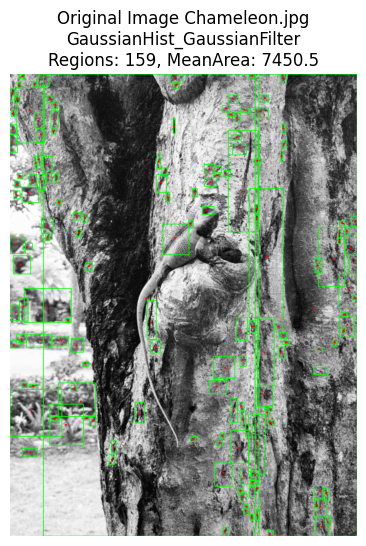

  GaussianHist_GaussianFilter: regions=159, mean_area=7450.5, PSNR=21.99, SSIM=0.8132


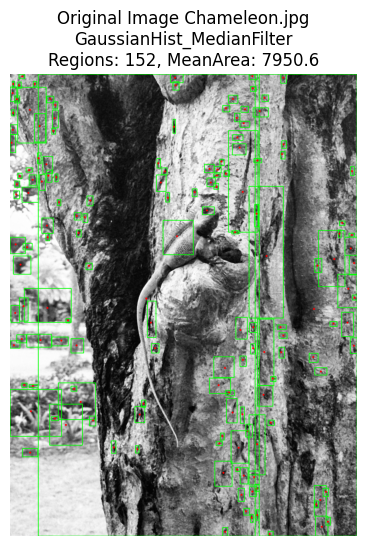

  GaussianHist_MedianFilter: regions=152, mean_area=7950.6, PSNR=20.07, SSIM=0.6378


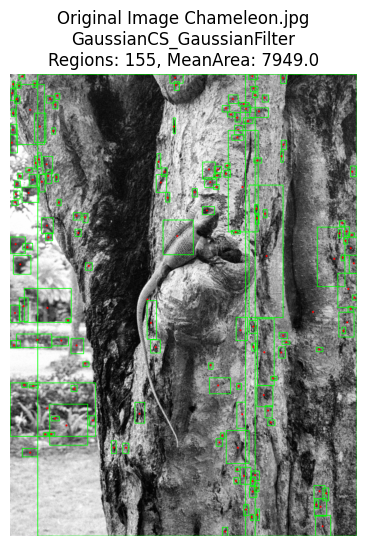

  GaussianCS_GaussianFilter: regions=155, mean_area=7949.0, PSNR=23.45, SSIM=0.8051


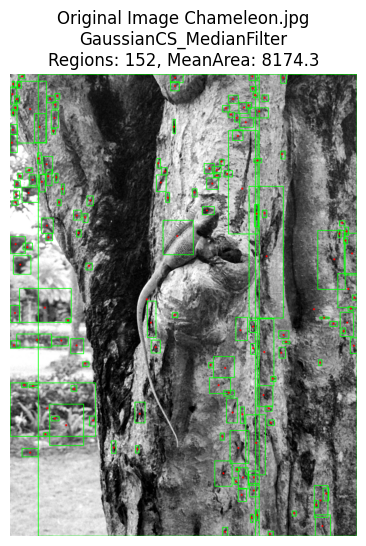

  GaussianCS_MedianFilter: regions=152, mean_area=8174.3, PSNR=21.38, SSIM=0.6300


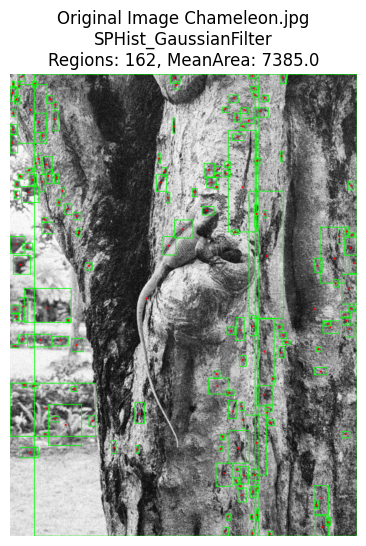

  SPHist_GaussianFilter: regions=162, mean_area=7385.0, PSNR=22.71, SSIM=0.7391


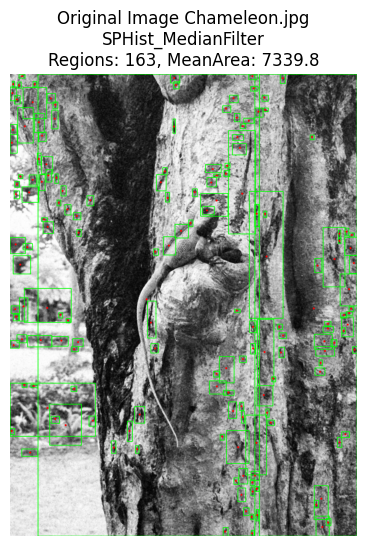

  SPHist_MedianFilter: regions=163, mean_area=7339.8, PSNR=20.03, SSIM=0.5821


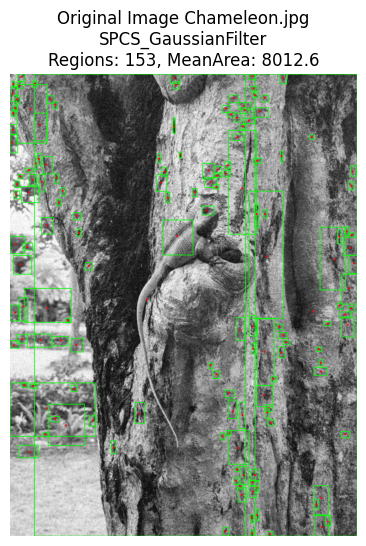

  SPCS_GaussianFilter: regions=153, mean_area=8012.6, PSNR=24.93, SSIM=0.7363


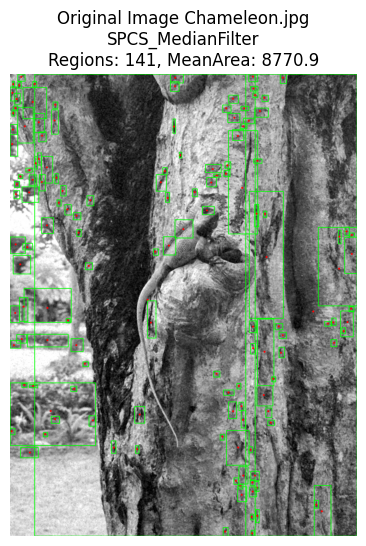

  SPCS_MedianFilter: regions=141, mean_area=8770.9, PSNR=22.31, SSIM=0.5713

Processing grayscale filtered variants of: Original Image Decor.jpg


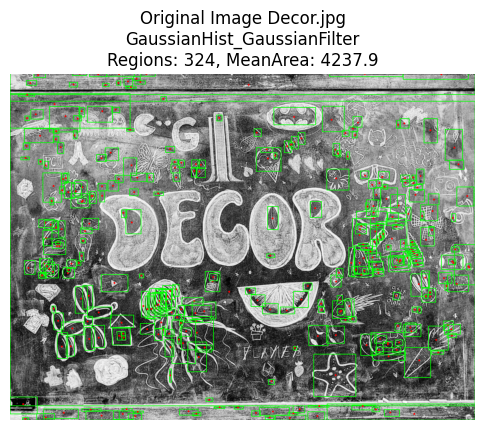

  GaussianHist_GaussianFilter: regions=324, mean_area=4237.9, PSNR=19.06, SSIM=0.7647


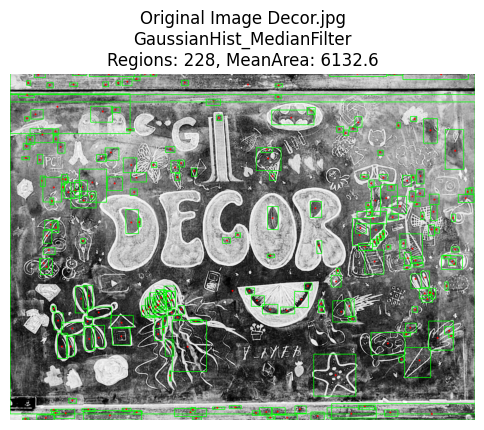

  GaussianHist_MedianFilter: regions=228, mean_area=6132.6, PSNR=16.69, SSIM=0.5501


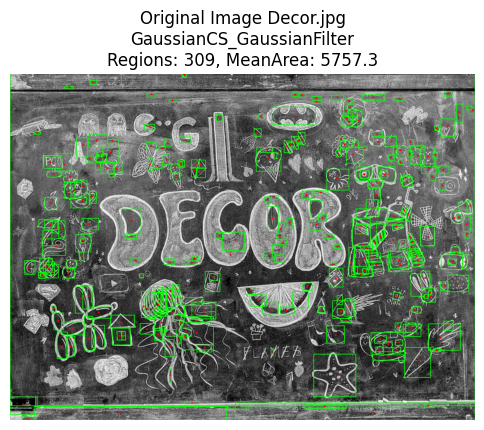

  GaussianCS_GaussianFilter: regions=309, mean_area=5757.3, PSNR=19.61, SSIM=0.7884


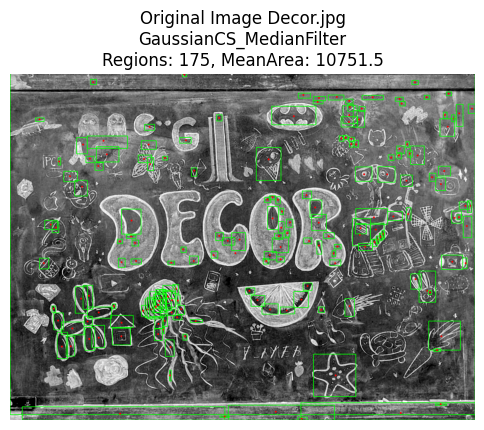

  GaussianCS_MedianFilter: regions=175, mean_area=10751.5, PSNR=17.87, SSIM=0.5738


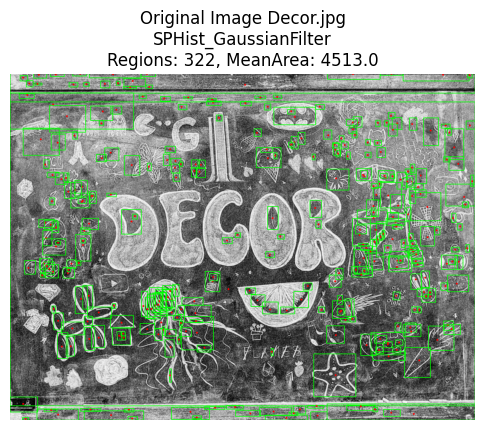

  SPHist_GaussianFilter: regions=322, mean_area=4513.0, PSNR=20.12, SSIM=0.6981


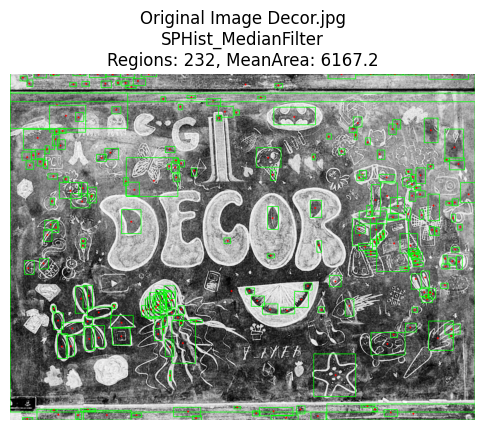

  SPHist_MedianFilter: regions=232, mean_area=6167.2, PSNR=17.22, SSIM=0.4976


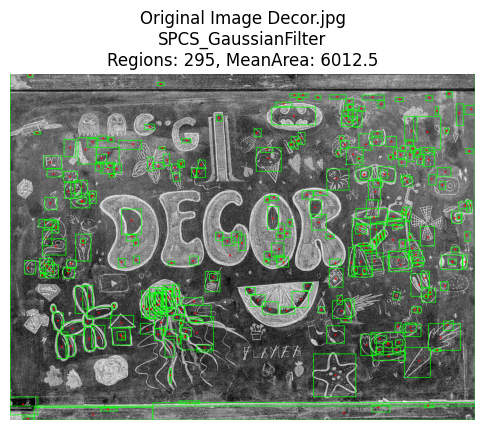

  SPCS_GaussianFilter: regions=295, mean_area=6012.5, PSNR=19.89, SSIM=0.7199


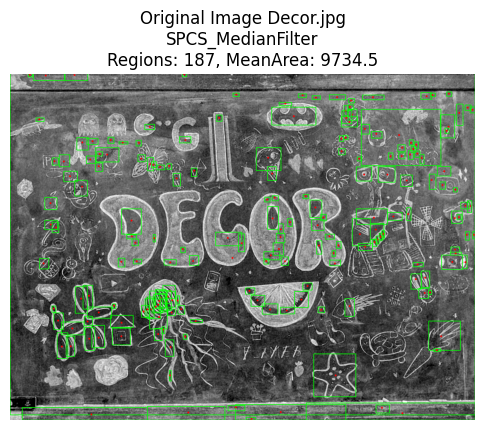

  SPCS_MedianFilter: regions=187, mean_area=9734.5, PSNR=18.13, SSIM=0.5209

Processing grayscale filtered variants of: Original Image EB.jpg


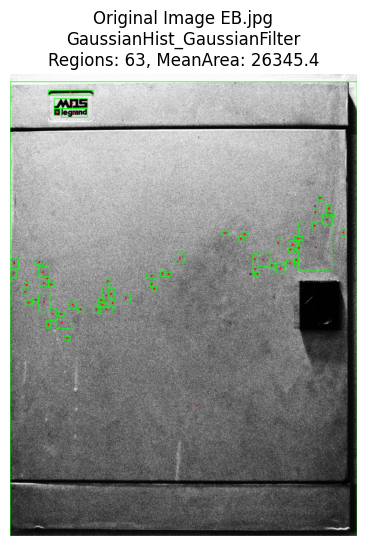

  GaussianHist_GaussianFilter: regions=63, mean_area=26345.4, PSNR=12.57, SSIM=0.3183


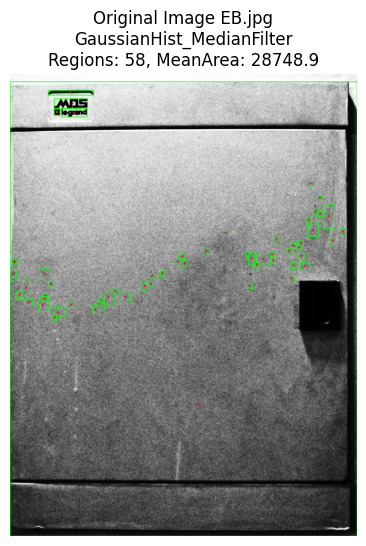

  GaussianHist_MedianFilter: regions=58, mean_area=28748.9, PSNR=11.98, SSIM=0.3183


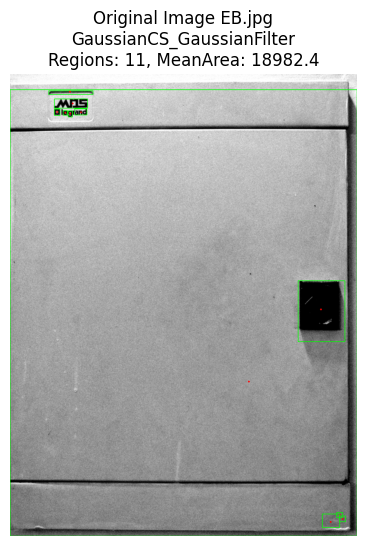

  GaussianCS_GaussianFilter: regions=11, mean_area=18982.4, PSNR=20.52, SSIM=0.6136


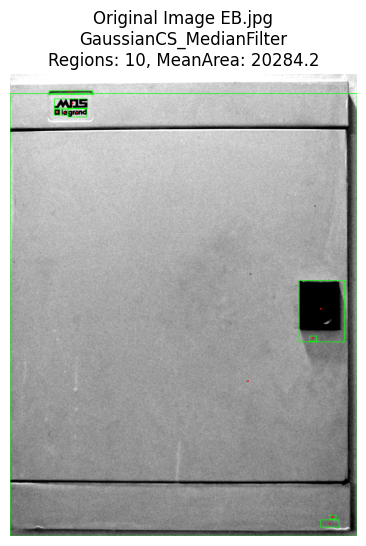

  GaussianCS_MedianFilter: regions=10, mean_area=20284.2, PSNR=20.39, SSIM=0.6509


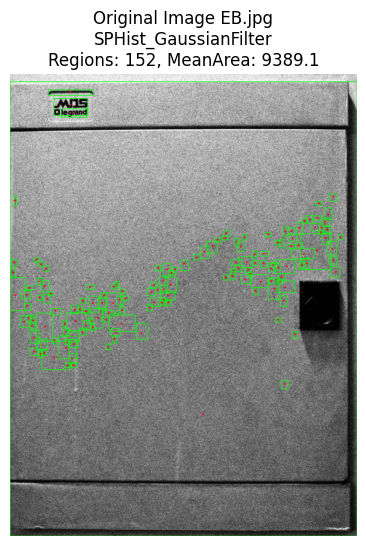

  SPHist_GaussianFilter: regions=152, mean_area=9389.1, PSNR=13.71, SSIM=0.2384


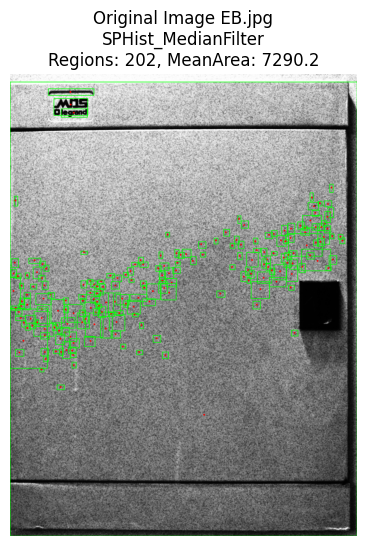

  SPHist_MedianFilter: regions=202, mean_area=7290.2, PSNR=13.59, SSIM=0.2010


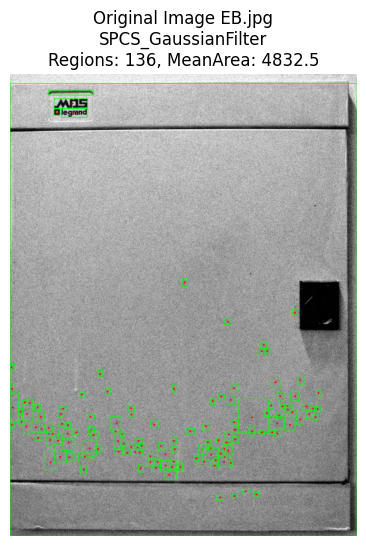

  SPCS_GaussianFilter: regions=136, mean_area=4832.5, PSNR=20.01, SSIM=0.3863


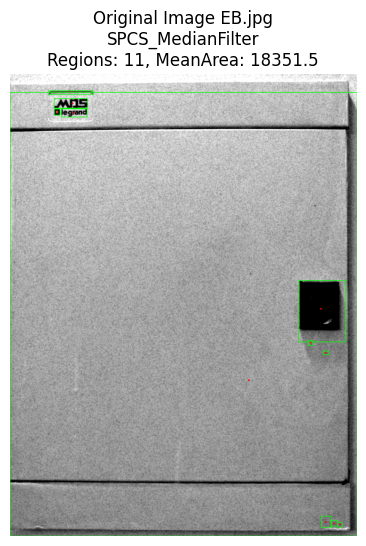

  SPCS_MedianFilter: regions=11, mean_area=18351.5, PSNR=20.94, SSIM=0.4050

Processing grayscale filtered variants of: Original Image FW.jpg


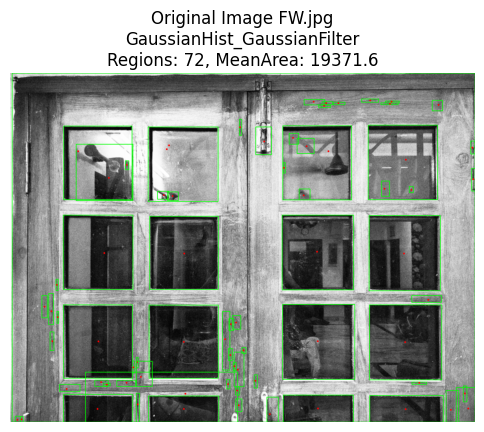

  GaussianHist_GaussianFilter: regions=72, mean_area=19371.6, PSNR=15.15, SSIM=0.6967


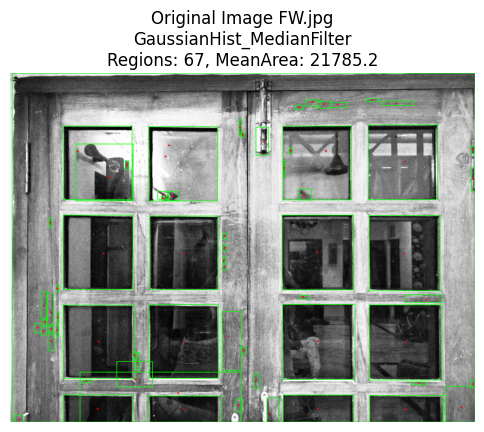

  GaussianHist_MedianFilter: regions=67, mean_area=21785.2, PSNR=14.73, SSIM=0.5799


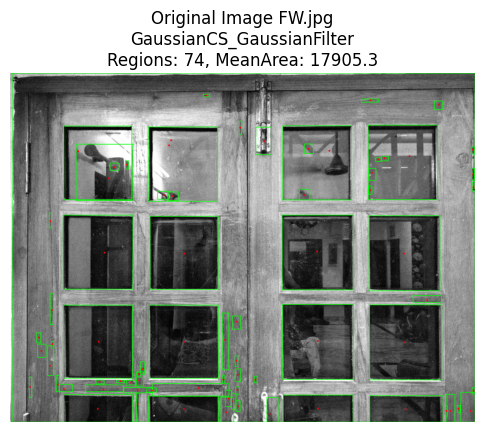

  GaussianCS_GaussianFilter: regions=74, mean_area=17905.3, PSNR=19.42, SSIM=0.7439


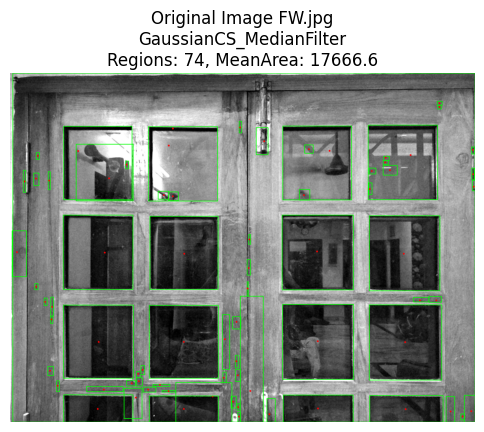

  GaussianCS_MedianFilter: regions=74, mean_area=17666.6, PSNR=19.08, SSIM=0.6213


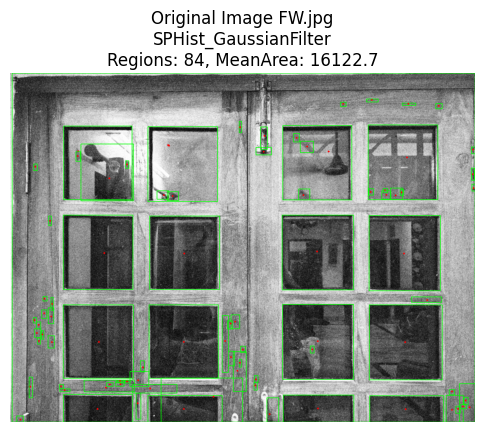

  SPHist_GaussianFilter: regions=84, mean_area=16122.7, PSNR=15.96, SSIM=0.5313


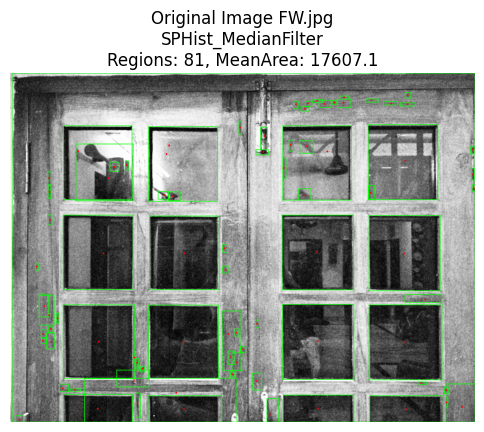

  SPHist_MedianFilter: regions=81, mean_area=17607.1, PSNR=15.37, SSIM=0.4558


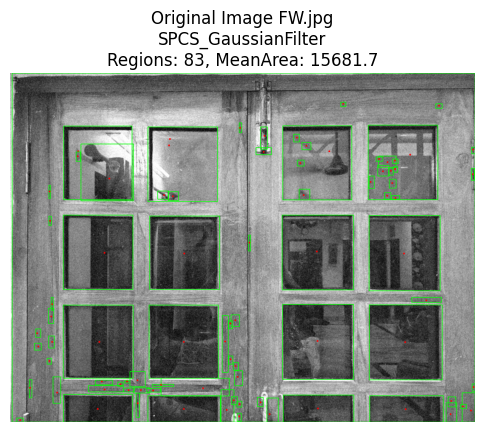

  SPCS_GaussianFilter: regions=83, mean_area=15681.7, PSNR=18.57, SSIM=0.5859


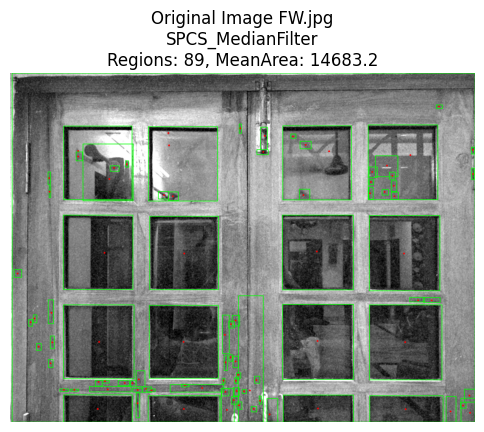

  SPCS_MedianFilter: regions=89, mean_area=14683.2, PSNR=18.54, SSIM=0.5016


In [19]:
import numpy as np
import matplotlib.pyplot as plt
import cv2
from skimage.measure import label, regionprops
from skimage.metrics import structural_similarity as ssim

# Function to extract and annotate regions (grayscale version)
def extract_regions_and_annotate(gray_img, min_area=150):
    # Threshold
    _, mask = cv2.threshold(gray_img, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)
    mask = mask.astype(np.uint8)

    # Label connected components
    labeled = label(mask)
    props = regionprops(labeled)

    # Prepare RGB image for annotation
    annotated = cv2.cvtColor(gray_img, cv2.COLOR_GRAY2RGB)

    features = []
    for prop in props:
        if prop.area < min_area:
            continue
        y1, x1, y2, x2 = prop.bbox
        cy, cx = prop.centroid

        # Draw bounding box and centroid
        cv2.rectangle(annotated, (x1, y1), (x2, y2), (0,255,0), 2)
        cv2.circle(annotated, (int(cx), int(cy)), 4, (255,0,0), -1)
        features.append({'area': prop.area, 'centroid': (cx, cy)})

    return annotated, features, mask

# ------------------------------------------------------
# Run segmentation-like analysis on each filtered grayscale output
# ------------------------------------------------------

segmentation_filtered_results = {}

for path, results in filtered_results_dict.items():
    print(f"\nProcessing grayscale filtered variants of: {path.split('/')[-1]}")

    seg_results = {}

    # Original grayscale (resized for PSNR/SSIM comparison)
    gray_ref = cv2.resize(images_gray[path],
                          (int(images_gray[path].shape[1]*scale), int(images_gray[path].shape[0]*scale)),
                          interpolation=cv2.INTER_AREA)

    for title, img in results.items():
        annotated, features, mask = extract_regions_and_annotate(img, min_area=150)
        num_regions = len(features)
        mean_area = np.mean([f['area'] for f in features]) if features else 0

        psnr_val = cv2.PSNR(gray_ref, img)
        ssim_val = ssim(gray_ref, img, data_range=255)

        seg_results[title] = {
            'annotated': annotated,
            'features': features,
            'mask': mask,
            'num_regions': num_regions,
            'mean_area': mean_area,
            'psnr': psnr_val,
            'ssim': ssim_val
        }

        # Display annotated image
        plt.figure(figsize=(6,6))
        plt.imshow(annotated)
        plt.title(f"{path.split('/')[-1]}\n{title}\nRegions: {num_regions}, MeanArea: {mean_area:.1f}")
        plt.axis("off")
        plt.show()

        # Print numeric summary
        print(f"  {title}: regions={num_regions}, mean_area={mean_area:.1f}, PSNR={psnr_val:.2f}, SSIM={ssim_val:.4f}")

    segmentation_filtered_results[path] = seg_results
